In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# My Prompt
**"A plus sized mode is posing with a pink top and black jean. Studio background and studio lighting. Photorealistic"**

In [1]:
!pip install transformers diffusers accelerate

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 9.7 MB/s eta 0:00:00ta 0:00:01


In [4]:
from diffusers import StableDiffusionPipeline, DPMSolverMultistepScheduler, AutoPipelineForText2Image
import torch

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

2024-02-23 04:08:23.226112: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-23 04:08:23.226213: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-23 04:08:23.406225: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [5]:
torch.cuda.is_available()

True

In [7]:
# prompts = ["A model wearing a black designer gown. Background is paris, model is standing in middle of the road. Photorealistic",
#            "A cute kid posing with yellow skirt and hat. Background is taj mahal and sunlight from behind. Photorealistic",
#             "A plus sized mode is posing with a pink top and black jean. Studio background adn studio lighting. Photorealistic"
#            ]

prompt = "A plus sized mode is posing with a pink top and black jean. Studio background and studio lighting. Photorealistic"

# Base Model Comparisions

## Stable Diffusion - 2.1

In [4]:
model_id = "stabilityai/stable-diffusion-2-1"
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe = pipe.to("cuda")

model_index.json:   0%|          | 0.00/537 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

text_encoder/config.json:   0%|          | 0.00/633 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/824 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/345 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/939 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/611 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [8]:
result_image = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

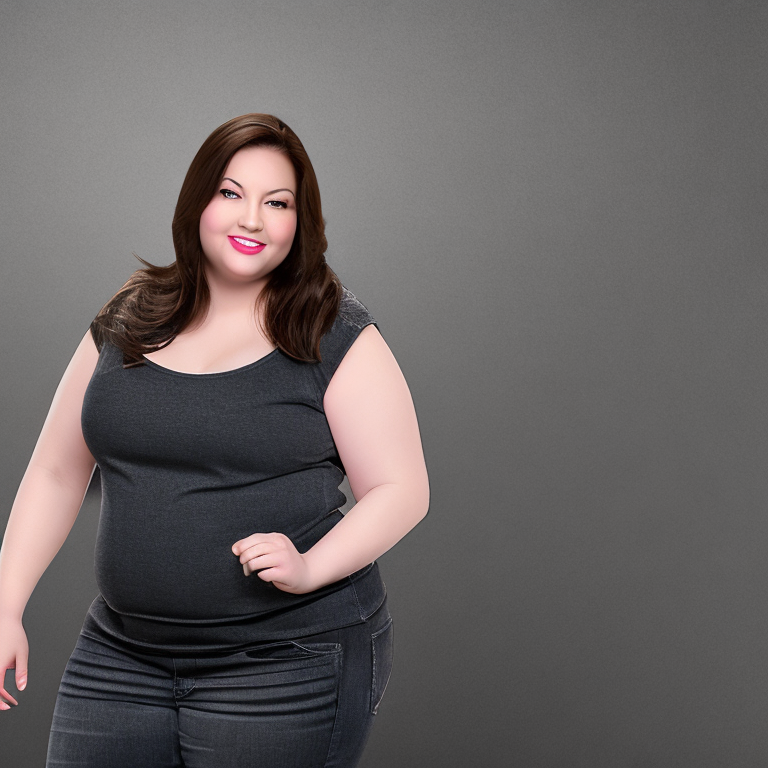

In [9]:
result_image

### Add HyperParameters

num_inference_steps, guidance_scale

In [12]:
result_image = pipe(prompt, num_inference_steps=70, guidance_scale=2).images[0]

  0%|          | 0/70 [00:00<?, ?it/s]

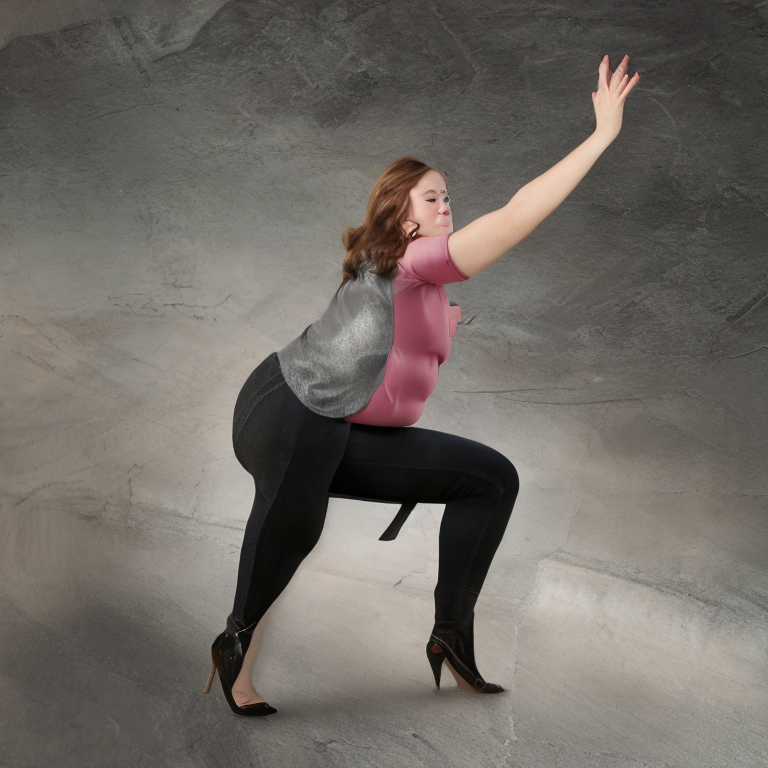

In [13]:
result_image

## Lykon/dreamshaper-xl-v2-turbo

In [20]:
model_id = "lykon/dreamshaper-xl-v2-turbo"
pipe = AutoPipelineForText2Image.from_pretrained('lykon/dreamshaper-xl-v2-turbo', torch_dtype=torch.float16, variant="fp16")
pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)
pipe = pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [23]:
image = pipe(prompt, num_inference_steps=15, guidance_scale=2).images[0]

  0%|          | 0/15 [00:00<?, ?it/s]

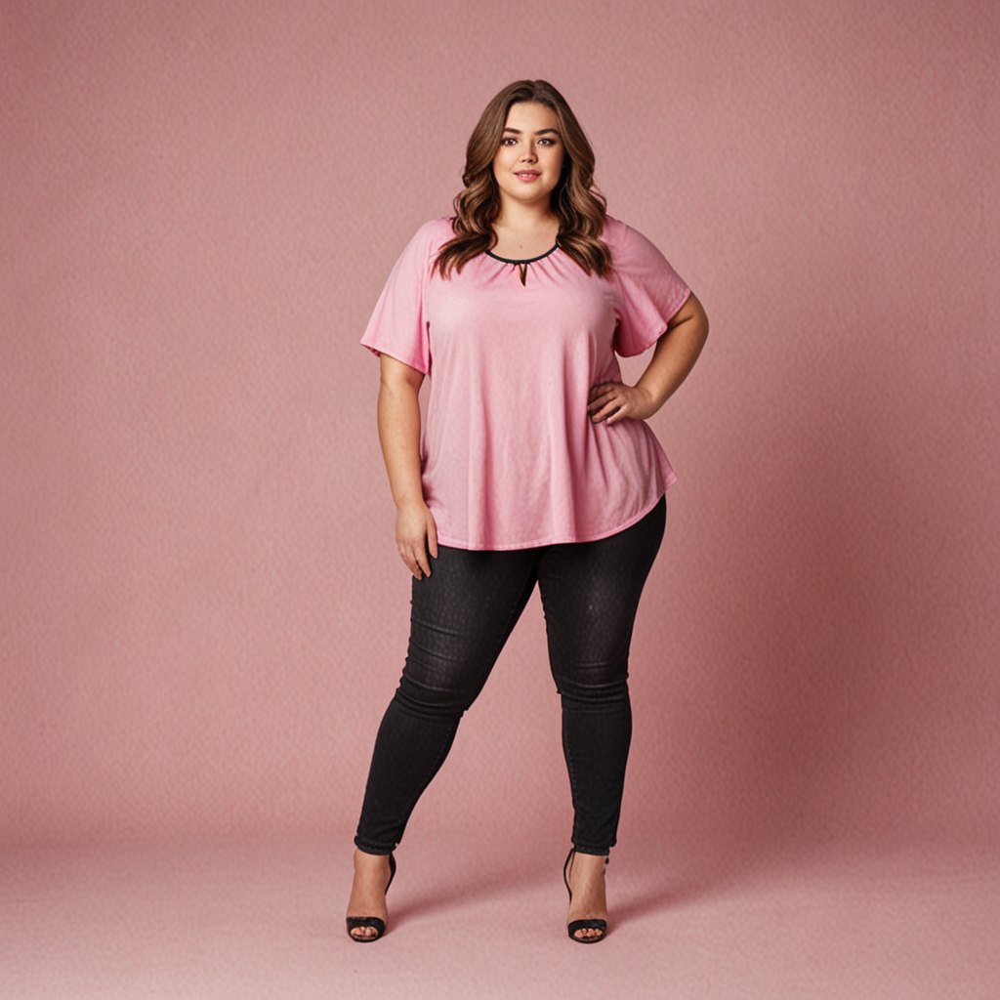

In [24]:
image

## dreamlike-art/dreamlike-photoreal-2.0

In [25]:
model_id = "dreamlike-art/dreamlike-photoreal-2.0"
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe = pipe.to("cuda")

model_index.json:   0%|          | 0.00/511 [00:00<?, ?B/s]

Fetching 12 files:   0%|          | 0/12 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/807 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/341 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.72G [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/577 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/901 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

In [26]:
result_image = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

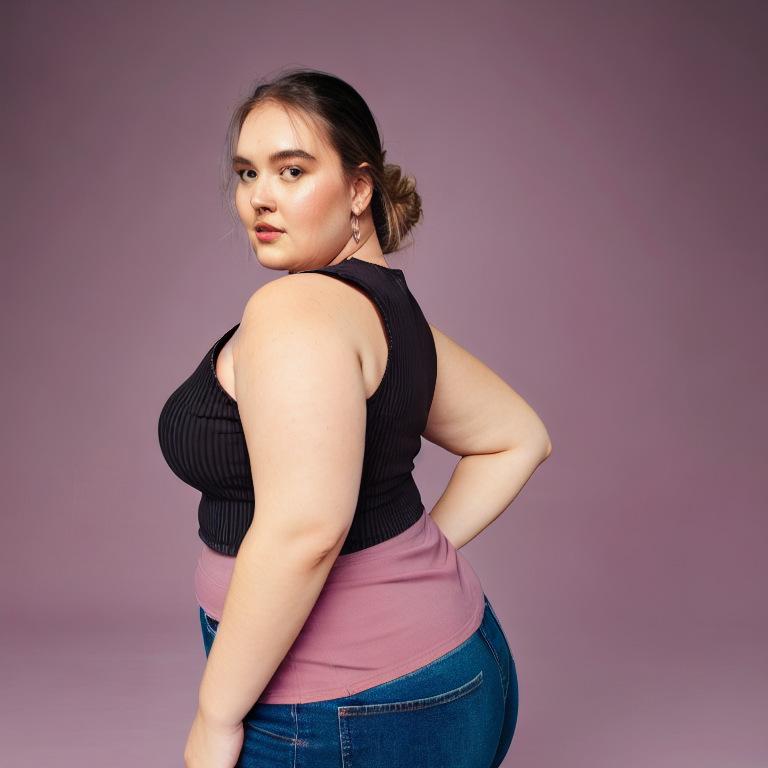

In [27]:
result_image

In [38]:
result_image = pipe(prompt, num_inference_steps=35, guidance_scale=2).images[0]

  0%|          | 0/35 [00:00<?, ?it/s]

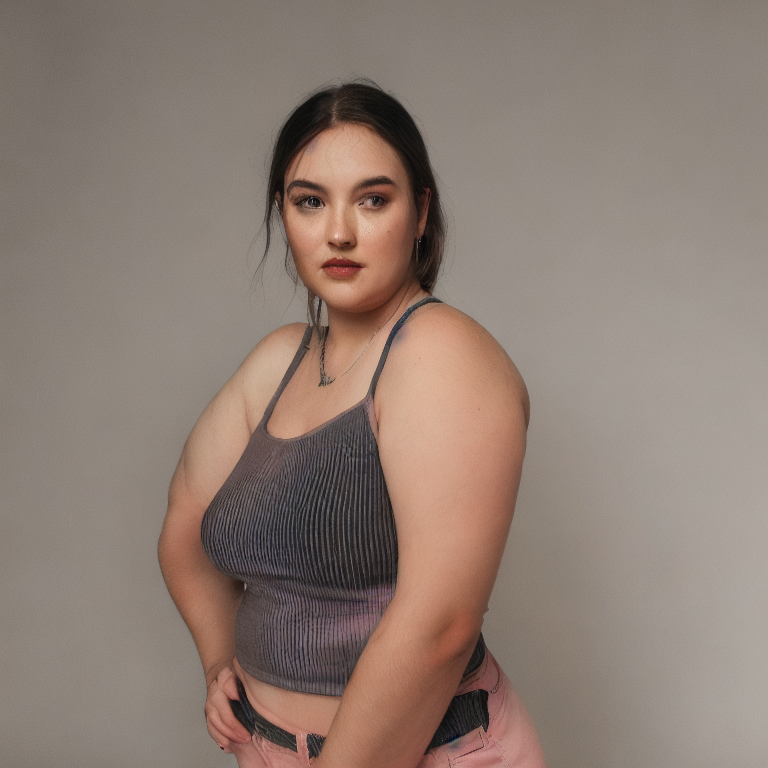

In [39]:
result_image

### Using AutoPipeline

In [40]:
model_id = "dreamlike-art/dreamlike-photoreal-2.0"
pipe = AutoPipelineForText2Image.from_pretrained(model_id, torch_dtype=torch.float16)
pipe = pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

In [41]:
result_image = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

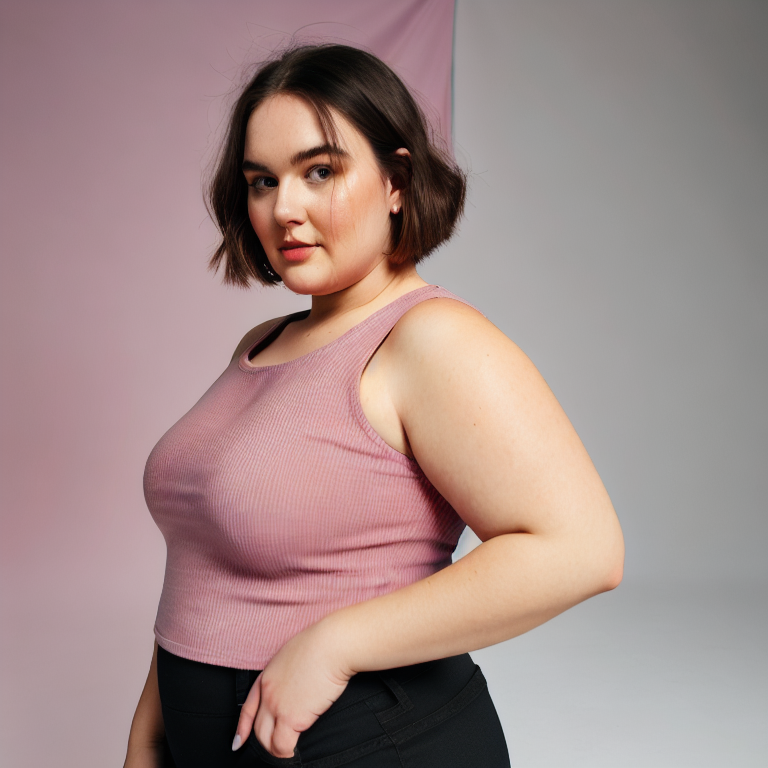

In [42]:
result_image

>**Best Base Model is Dreamlike Photoreal**

## Using DPMSolverMultistepScheduler

In [43]:
model_id = "dreamlike-art/dreamlike-photoreal-2.0"
pipe = AutoPipelineForText2Image.from_pretrained(model_id, torch_dtype=torch.float16)
pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)
pipe = pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

In [44]:
result_image = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

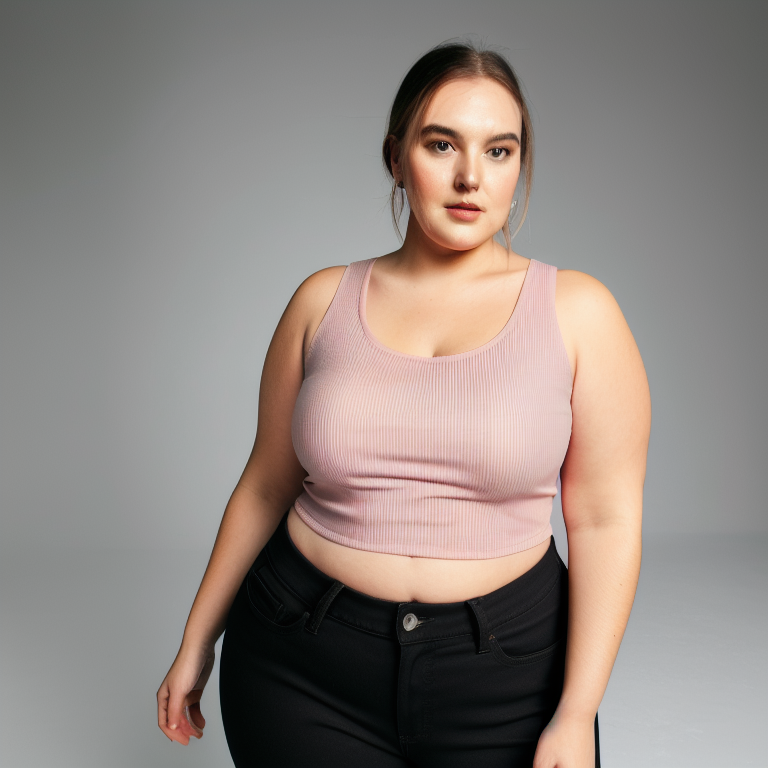

In [45]:
result_image

## Use ControlNetModel

In [46]:
!pip install controlnet_hinter==0.0.5

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.5/172.5 kB 5.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.5/547.5 kB 22.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.4/199.4 kB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 299.2/299.2 kB 18.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 76.1 MB/s eta 0:00:00:00:01
  Created wheel for basicsr: filename=basicsr-1.4.2-py3-none-any.whl size=214818 sha256=ffd1d1beb85a65e660a8eff8bbc420b5ff9bc257d505e32ae879ff1666af6f3e
  Stored in directory: /root/.cache/pip/wheels/38/83/99/2d8437cc652a01af27df5ff037a4075e95b52d67705c5f30ca
Successfully built basicsr


In [47]:
import controlnet_hinter
# Mapping for ControlNet Model path and hinter function
CONTROLNET_MAPPING = {
    "canny_edge": {
        "model_id": "lllyasviel/sd-controlnet-canny",
        "hinter": controlnet_hinter.hint_canny
    },
    "pose": {
        "model_id": "lllyasviel/sd-controlnet-openpose",
        "hinter": controlnet_hinter.hint_openpose
    },
    "depth": {
        "model_id": "lllyasviel/sd-controlnet-depth",
        "hinter": controlnet_hinter.hint_depth
    },
    "scribble": {
        "model_id": "lllyasviel/sd-controlnet-scribble",
        "hinter": controlnet_hinter.hint_scribble,
    },
    "segmentation": {
        "model_id": "lllyasviel/sd-controlnet-seg",
        "hinter": controlnet_hinter.hint_segmentation,
    },
    "normal": {
        "model_id": "lllyasviel/sd-controlnet-normal",
        "hinter": controlnet_hinter.hint_normal,
    },
    "hed": {
        "model_id": "lllyasviel/sd-controlnet-hed",
        "hinter": controlnet_hinter.hint_hed,
    },
    "hough": {
        "model_id": "lllyasviel/sd-controlnet-mlsd",
        "hinter": controlnet_hinter.hint_hough,
    }
}

In [48]:
from diffusers import ControlNetModel, StableDiffusionControlNetPipeline
from diffusers.utils import load_image

## Model - Juggernaut_Final

*ControlNet only supports a few models. In the future, we can add more models to recreate pose*

In [57]:
base_model_path =  "digiplay/Juggernaut_final"
controlnet_type = "pose"
device = "cuda"

In [58]:
controlnet = ControlNetModel.from_pretrained(CONTROLNET_MAPPING[controlnet_type]["model_id"], torch_dtype=torch.float16).to(device)

In [59]:
pipe = StableDiffusionControlNetPipeline.from_pretrained(base_model_path,
                                                         controlnet=controlnet,
                                                         torch_dtype=torch.float16,
                                                         ).to(device)

model_index.json:   0%|          | 0.00/593 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.58k [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/520 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/427 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.69k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/582 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


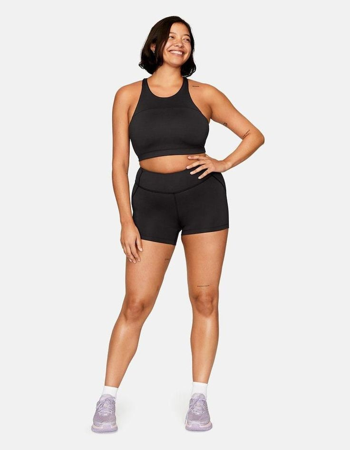

In [90]:
logo_image_url = "https://i.pinimg.com/736x/3b/4c/cd/3b4ccd8b5cd74b0e554c987d0ce4b14f.jpg"
logo_image = load_image(logo_image_url)
logo_image.resize((350,450))

In [86]:
no_of_steps = 50
guidace_scale = 7.0
controlnet_conditioning_scale=1.0
control_image = CONTROLNET_MAPPING[controlnet_type]["hinter"](logo_image )

In [87]:
my_image = pipe(
    prompt=prompt,
    image=control_image,
    num_inference_steps=no_of_steps,
    guidance_scale=guidace_scale,
    controlnet_conditioning_scale=controlnet_conditioning_scale
)

  0%|          | 0/50 [00:00<?, ?it/s]

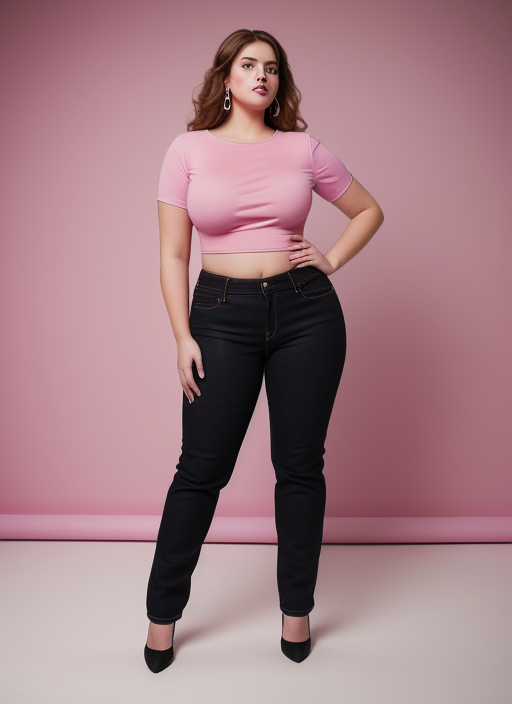

In [88]:
my_image.images[0]

# Improve the prompt

In [5]:
prompt = "A photorealistic portrait of a woman with a curvy figure, wearing a flowing red dress and sparkling jewelry, confidently posing in warm studio lighting. Her long, black hair is styled in loose waves, and she has a radiant smile on her face, 8k, UHD, DSLR"

In [23]:
model_id = "dreamlike-art/dreamlike-photoreal-2.0"
pipe = AutoPipelineForText2Image.from_pretrained(model_id, torch_dtype=torch.float16)
pipe = pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

In [7]:
result_image = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

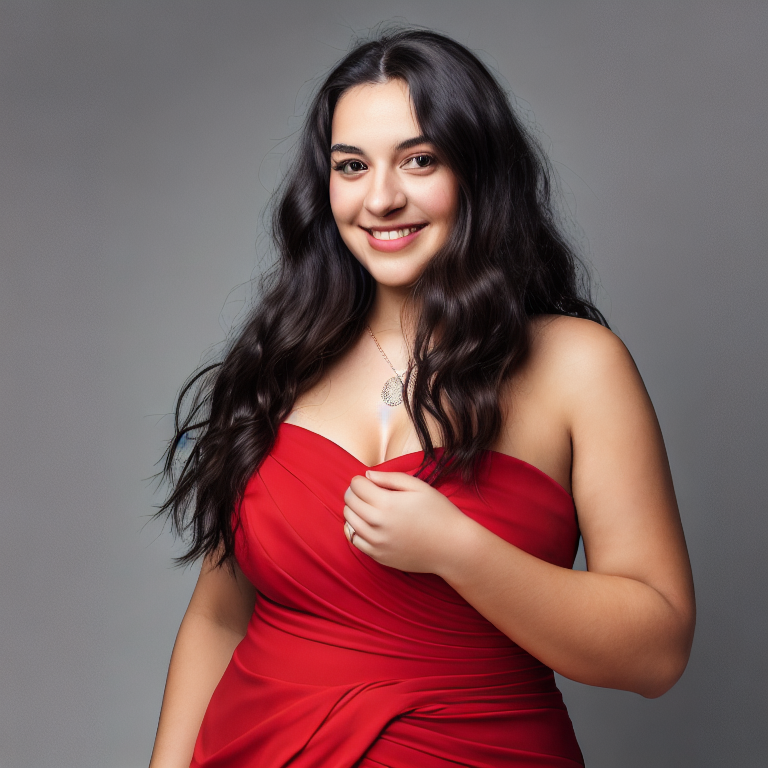

In [8]:
result_image

In [9]:
result_image = pipe(prompt, num_inference_steps = 75).images[0]

  0%|          | 0/75 [00:00<?, ?it/s]

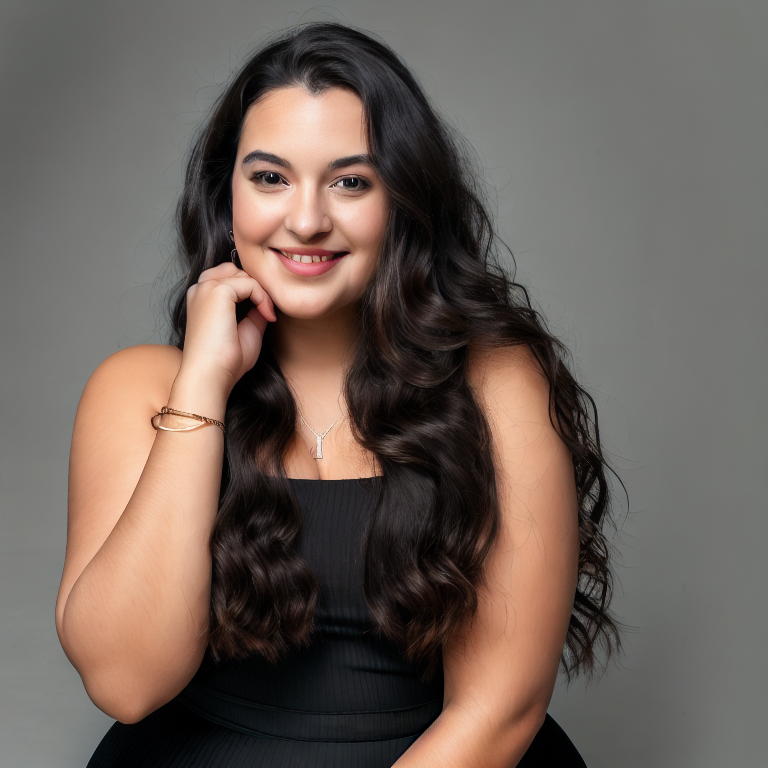

In [10]:
result_image

# Setup Pipeline

In [6]:
from diffusers import StableDiffusionPipeline, DDIMScheduler, DPMSolverMultistepScheduler, EulerAncestralDiscreteScheduler, KDPM2AncestralDiscreteScheduler
from torch.utils.data.dataset import Generator
from torch import autocast

In [21]:
# !pip install xformers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 218.2/218.2 MB 7.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 755.5/755.5 MB 2.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 1.4 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 86.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 68.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 40.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 13.2 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 28.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 12.9 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 8.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━

In [60]:
def gen_images(pipe):  
    images = pipe(
              prompt=prompt,
              negative_prompt=negative_prompt,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              guidance_scale=guidance_scale,
            ).images
    
    for img in images:
        img.save(f"Seed_0.png")
        display(img)

In [61]:
# Pipe function
def pipe(model_id,schedular,safety_checker=None):
    pipe = StableDiffusionPipeline.from_pretrained(model_id,
                                          scheduler=scheduler,
                                          safety_checker=None,
                                          torch_dtype=torch.float16).to("cuda")
    return pipe

In [62]:
def start_inference():
    gen_images(pipe(model_id,scheduler))

In [63]:
model_id = "dreamlike-art/dreamlike-photoreal-2.0"

DEVICE = "cuda"

# Shedulers
DPMMultistep = DPMSolverMultistepScheduler.from_pretrained(model_id, subfolder="scheduler")
DDIM = DDIMScheduler.from_pretrained(model_id, subfolder="scheduler")
EADS = EulerAncestralDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")
KDPM2 = KDPM2AncestralDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")

In [64]:
# Parameters
scheduler = DPMMultistep
prompt = "A plus sized mode is posing with a pink top and black jean. Studio background and studio lighting. Photorealistic"
negative_prompt = "ugly, morbid, extra fingers, poorly drawn hands , mutation , blurry, extra limbs, gross proportions , missing arms, mutated hands, long neck, duplicate, mutilated , mutilated hands, poorly drawn face, deformed, bad anatomy, cloned face , malformed limbs, missing legs, too many fingers" #@param {type:"string"}
height = 768 
width = 768
guidance_scale = 5
num_inference_steps = 30

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

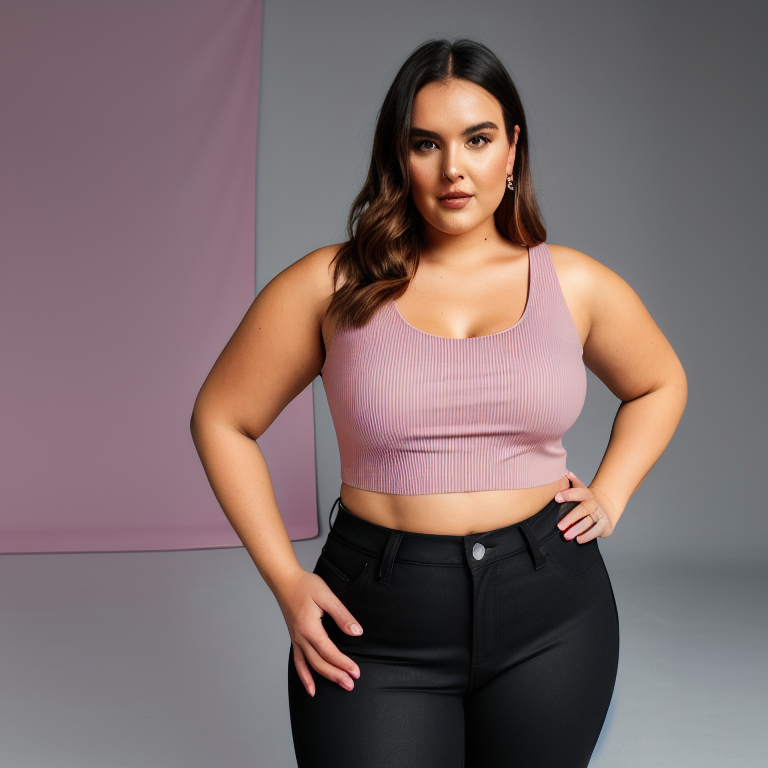

In [41]:
start_inference()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

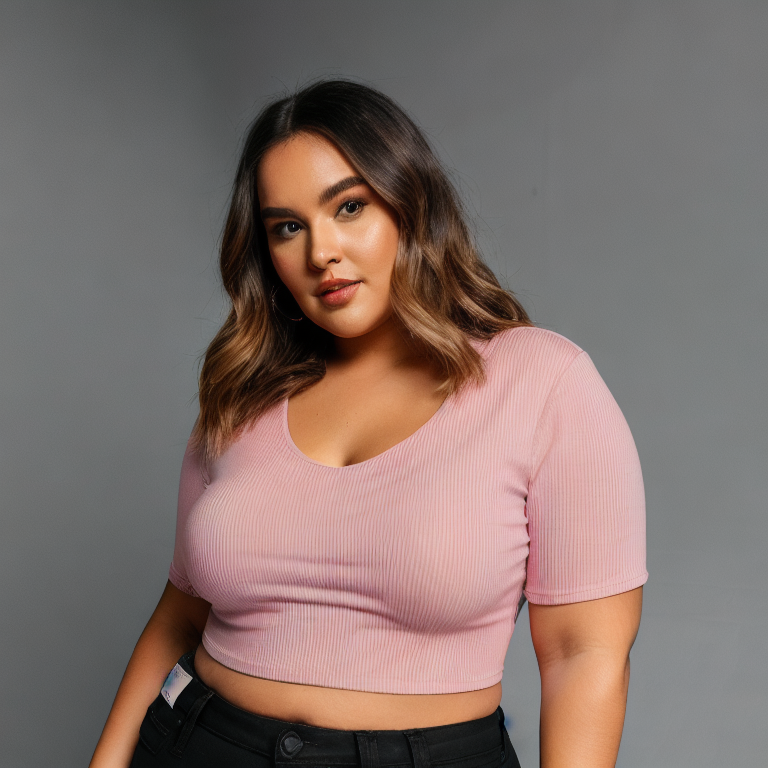

In [65]:
scheduler = DDIM
start_inference()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

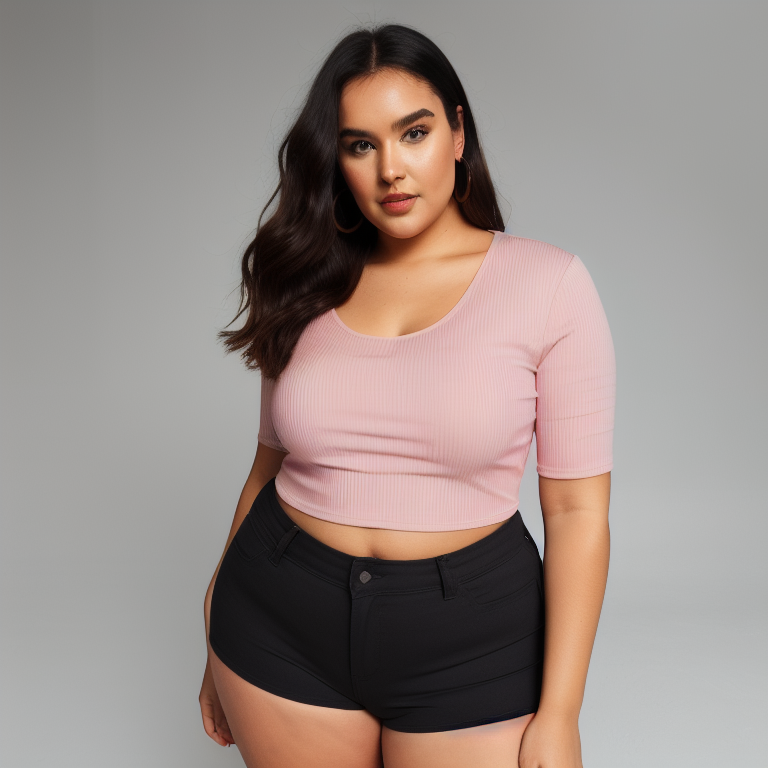

In [43]:
scheduler = EADS
start_inference()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

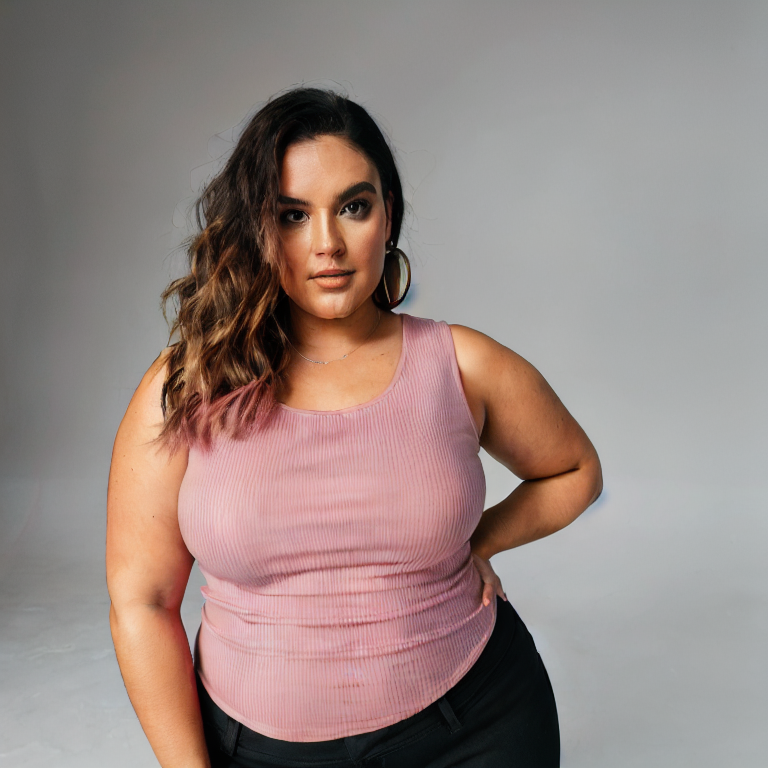

In [44]:
scheduler = KDPM2
start_inference()

# Upscale

In [7]:
from PIL import Image
from torchvision import transforms

In [2]:
image = Image.open("Seed_0.png")

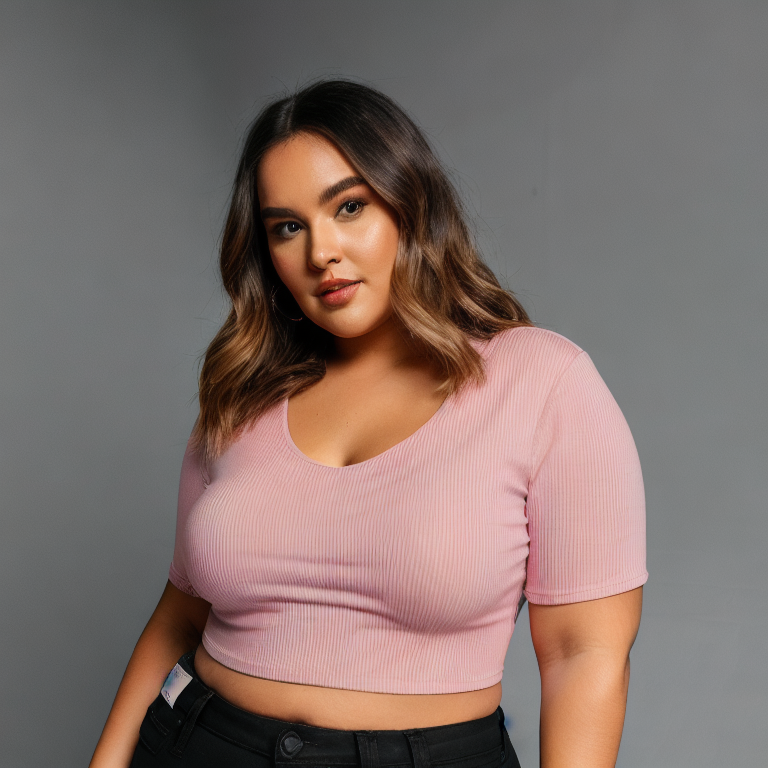

In [4]:
image

In [5]:
target_size = (2048, 2048)

In [15]:
upscale = transforms.Resize(target_size, interpolation=transforms.InterpolationMode.NEAREST)
upsampled_img = upscale(image)

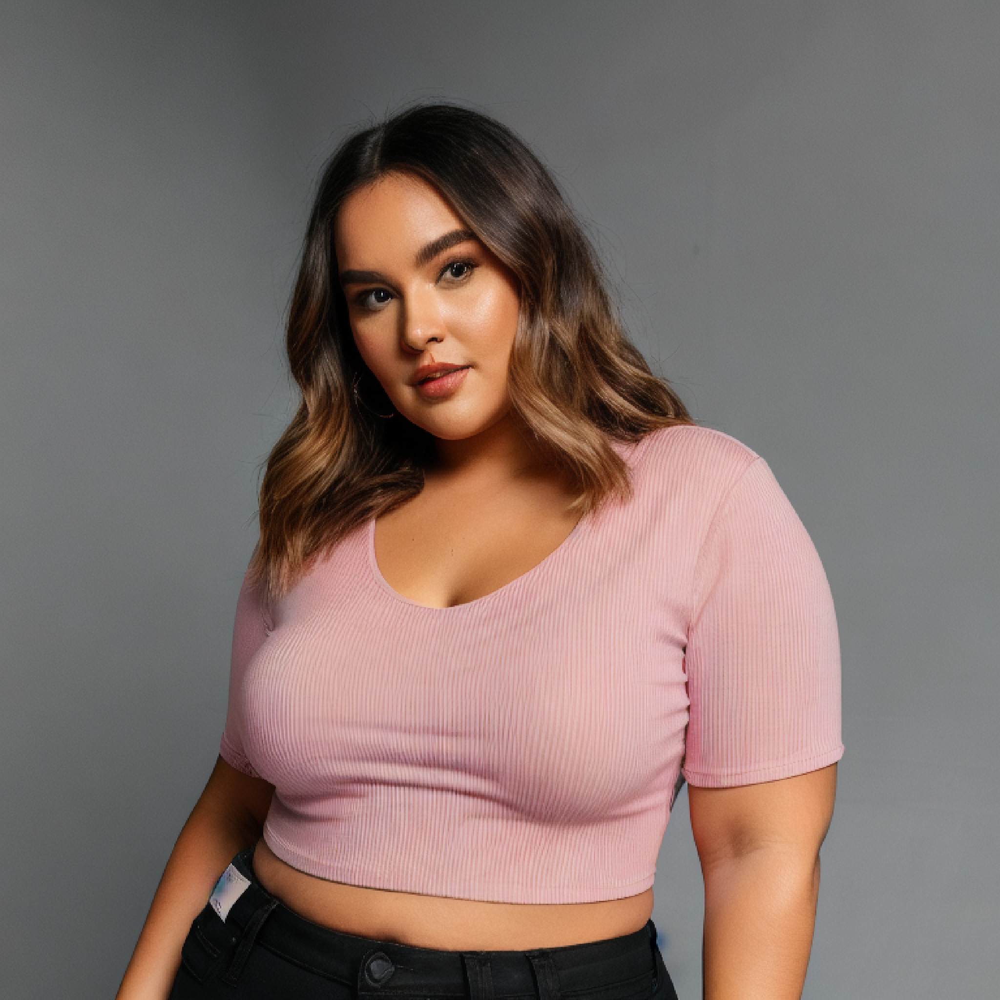

In [16]:
upsampled_img

In [17]:
upscale2 = transforms.Resize(target_size, interpolation=transforms.InterpolationMode.BILINEAR)
upsampled_img2 = upscale2(image)

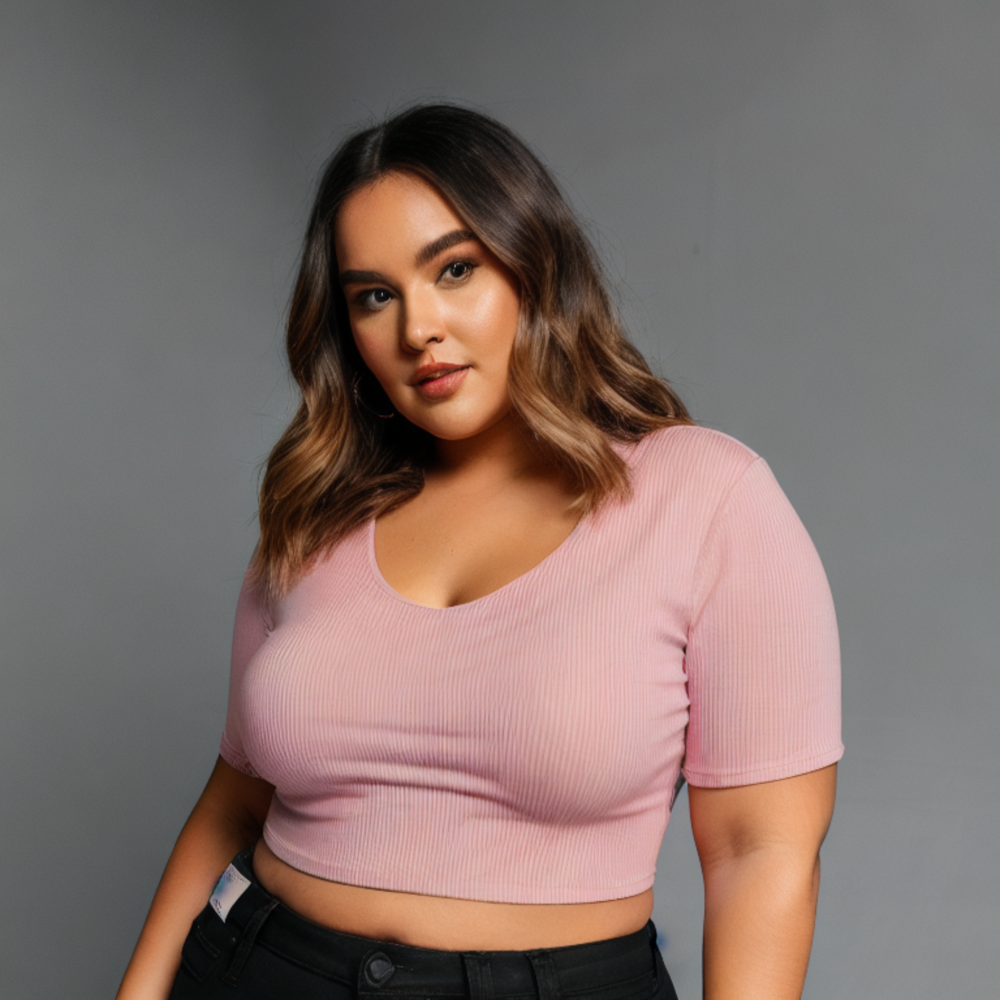

In [18]:
upsampled_img2

In [19]:
upscale3 = transforms.Resize(target_size, interpolation=transforms.InterpolationMode.BICUBIC)
upsampled_img3 = upscale3(image)

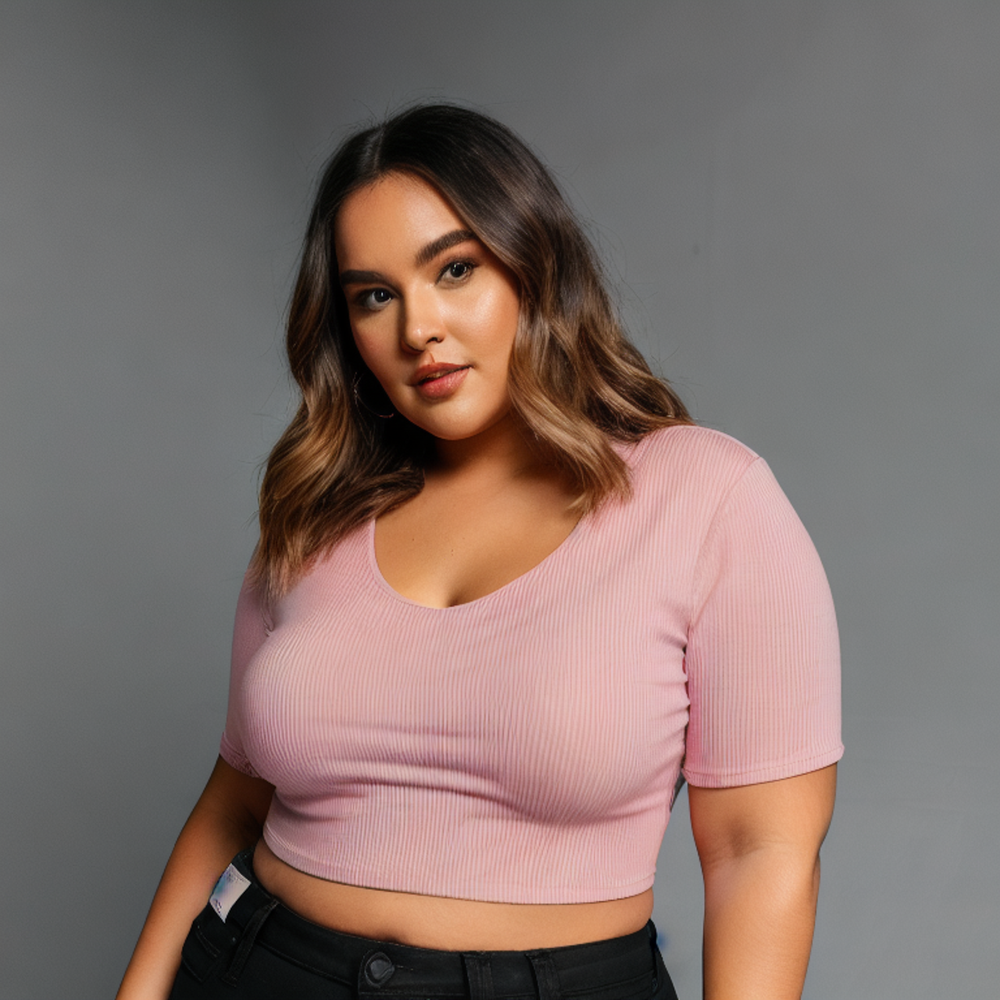

In [20]:
upsampled_img3

In [21]:
upsampled_img3.save("upscaled_image.jpg")

## Using Diffuser

In [7]:
from diffusers import StableDiffusionUpscalePipeline
import torch

In [8]:
model_id = "stabilityai/stable-diffusion-x4-upscaler"
pipeline = StableDiffusionUpscalePipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipeline = pipeline.to("cuda")

model_index.json:   0%|          | 0.00/485 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/634 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/348 [00:00<?, ?B/s]

low_res_scheduler/scheduler_config.json:   0%|          | 0.00/300 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/825 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/982 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/587 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.89G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/221M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [15]:
image = Image.open("upscaled_image.jpg")

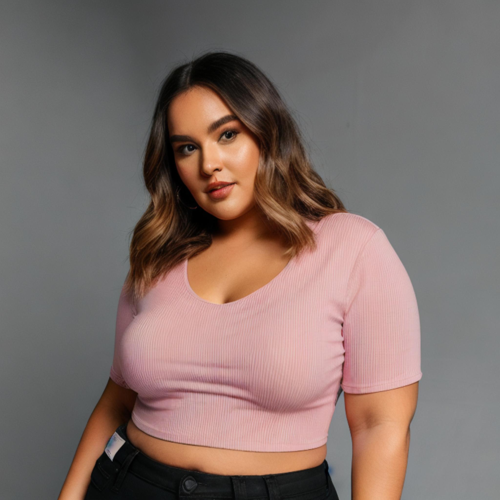

In [16]:
image.resize((500,500))

In [17]:
prompt = "an model, UHD, 4k, hyper realistic, extremely detailed, professional, not grainy, smooth"
upscaled_image2 = pipeline(prompt=prompt, image=image).images[0]
upscaled_image2

  0%|          | 0/75 [00:00<?, ?it/s]

OutOfMemoryError: CUDA out of memory. Tried to allocate 4.00 GiB. GPU 0 has a total capacty of 14.75 GiB of which 343.06 MiB is free. Process 2464 has 14.41 GiB memory in use. Of the allocated memory 13.33 GiB is allocated by PyTorch, and 969.85 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

# ULTIMATE PIPLINE

In [31]:
# !pip install transformers diffusers accelerate

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 39.4 MB/s eta 0:00:0000:01


In [94]:
from diffusers import StableDiffusionPipeline, DPMSolverMultistepScheduler, AutoPipelineForText2Image, DDIMScheduler, DPMSolverMultistepScheduler, EulerAncestralDiscreteScheduler, KDPM2AncestralDiscreteScheduler
import torch

In [95]:
def upscale_image(image):
    upscale = transforms.Resize(target_size, interpolation=transforms.InterpolationMode.BICUBIC)
    upsampled_img = upscale(image)
    return upsampled_img

In [96]:
def gen_images(pipe):  
    images = pipe(
              prompt=prompt,
              negative_prompt=negative_prompt,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              guidance_scale=guidance_scale,
            ).images
    img = images[0]
    img.save("base_generated.jpg")
    up_img = upscale_image(img)
    up_img.save("upscaled_generated.jpg")

In [97]:
def pipe(model_id,schedular,safety_checker=None):
    pipe = StableDiffusionPipeline.from_pretrained(model_id,
                                          scheduler=scheduler,
                                          safety_checker=None,
                                          torch_dtype=torch.float16).to("cuda")
    return pipe

In [98]:
def start_inference():
    gen_images(pipe(model_id,scheduler))

In [99]:
model_id = "dreamlike-art/dreamlike-photoreal-2.0"

DEVICE = "cuda"

In [100]:
DPMMultistep = DPMSolverMultistepScheduler.from_pretrained(model_id, subfolder="scheduler")
DDIM = DDIMScheduler.from_pretrained(model_id, subfolder="scheduler")
EADS = EulerAncestralDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")
KDPM2 = KDPM2AncestralDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")

In [104]:
# Parameters
scheduler = DPMMultistep
prompt = "A plus sized mode is posing with a pink top and black jean. Studio background and studio lighting. Photorealistic"
negative_prompt = "ugly, morbid, extra fingers, poorly drawn hands , mutation , blurry, extra limbs, gross proportions , missing arms, mutated hands, long neck, duplicate, mutilated , mutilated hands, poorly drawn face, deformed, bad anatomy, cloned face , malformed limbs, missing legs, too many fingers" 
height = 768 
width = 768
guidance_scale = 5
num_inference_steps = 30
target_size = (2048, 2048)

In [105]:
start_inference()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

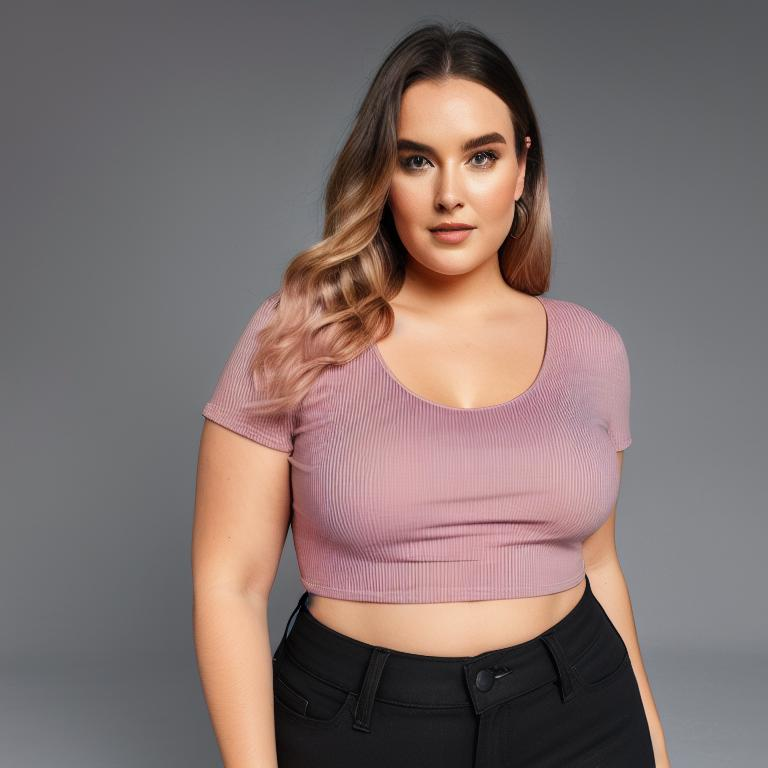

In [106]:
generated_image = Image.open("base_generated.jpg")
generated_image

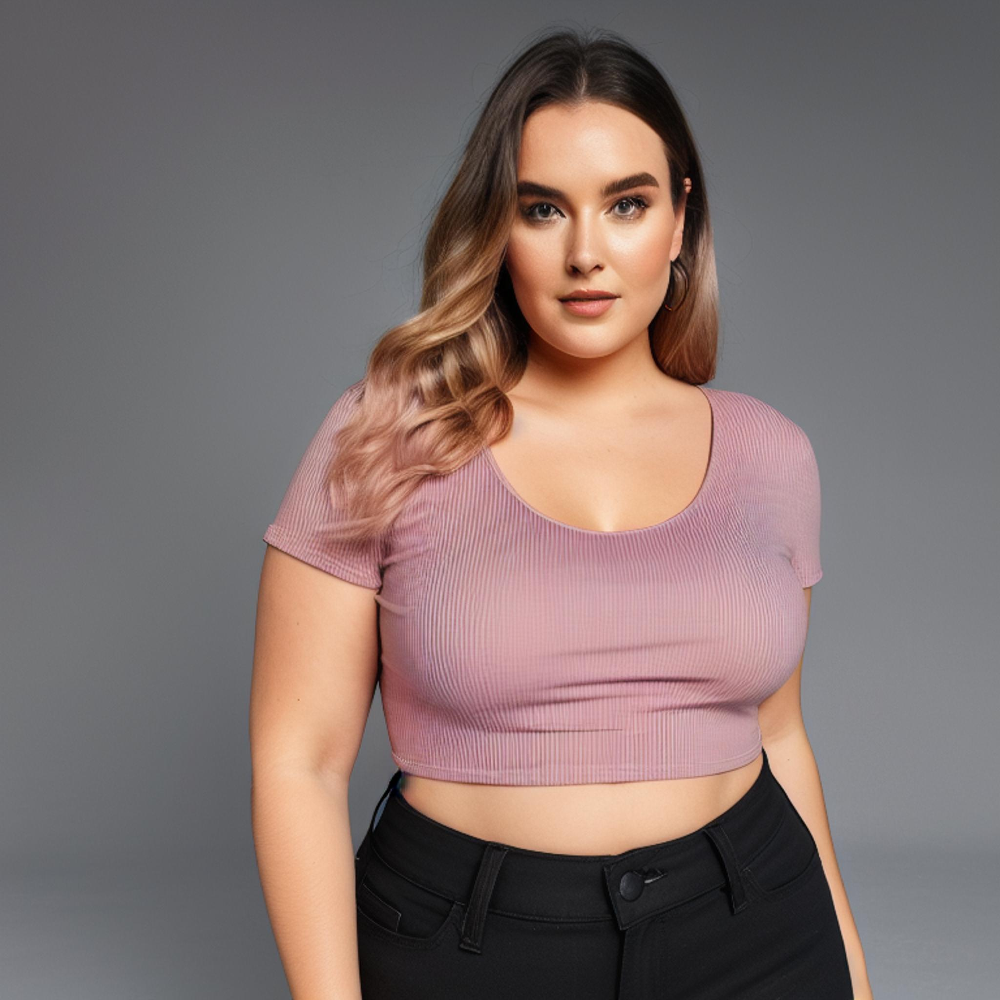

In [107]:
upscaled_generated_image = Image.open("upscaled_generated.jpg")
upscaled_generated_image